<a href="https://colab.research.google.com/github/mlartorg/visualML/blob/master/lucid_movie.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##### Copyright 2018 Google LLC.

Licensed under the Apache License, Version 2.0 (the "License");

In [0]:
# Licensed under the Apache License, Version 2.0 (the "License");
# you may not use this file except in compliance with the License.
# You may obtain a copy of the License at
#
# https://www.apache.org/licenses/LICENSE-2.0
#
# Unless required by applicable law or agreed to in writing, software
# distributed under the License is distributed on an "AS IS" BASIS,
# WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
# See the License for the specific language governing permissions and
# limitations under the License.

## Install, Import, Load Model

In [0]:
%tensorflow_version 1.x

In [9]:
!nvidia-smi

Sat May 16 05:11:58 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 440.82       Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|===============================+======================+======================|
|   0  Tesla P4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   46C    P8     7W /  75W |      0MiB /  7611MiB |      0%      Default |
+-------------------------------+----------------------+----------------------+
                                                                               
+-----------------------------------------------------------------------------+
| Processes:                                                       GPU Memory |
|  GPU  

In [0]:
!pip install -q moviepy

In [11]:
%cd /content
!git clone https://github.com/tensorflow/lucid
%cd lucid
!python setup.py install

/content
fatal: destination path 'lucid' already exists and is not an empty directory.
/content/lucid
running install
running bdist_egg
running egg_info
writing lucid.egg-info/PKG-INFO
writing dependency_links to lucid.egg-info/dependency_links.txt
writing requirements to lucid.egg-info/requires.txt
writing top-level names to lucid.egg-info/top_level.txt
reading manifest template 'MANIFEST.in'
writing manifest file 'lucid.egg-info/SOURCES.txt'
installing library code to build/bdist.linux-x86_64/egg
running install_lib
running build_py
creating build/bdist.linux-x86_64/egg
creating build/bdist.linux-x86_64/egg/lucid
creating build/bdist.linux-x86_64/egg/lucid/scratch
creating build/bdist.linux-x86_64/egg/lucid/scratch/pretty_graphs
copying build/lib/lucid/scratch/pretty_graphs/format_graph.py -> build/bdist.linux-x86_64/egg/lucid/scratch/pretty_graphs
copying build/lib/lucid/scratch/pretty_graphs/visualizations.py -> build/bdist.linux-x86_64/egg/lucid/scratch/pretty_graphs
copying build

In [0]:
# Imports
from scipy import ndimage

import numpy as np
import tensorflow as tf

from lucid.modelzoo import vision_models
from lucid.misc.io import show, load
from lucid.misc.tfutil import create_session
# from lucid.misc.ndimage_utils import resize

import lucid.optvis.objectives as objectives
import lucid.optvis.param as param
import lucid.optvis.render as render

from lucid.optvis.objectives import wrap_objective

# Iterative DeepDream


In [0]:
from lucid.optvis import transform

def make_print_objective_func(print_objectives, T):
  print_objectives = print_objectives or []
  po_descriptions = [obj.description for obj in print_objectives]
  pos = [obj(T) for obj in print_objectives]

  def print_objective_func(sess):
    pos_results = sess.run(pos)
    for k, v, i in zip(po_descriptions, pos_results, range(len(pos_results))):
      print("{:02d}: {}: {:7.2f}".format(i+1, k, v))

  return print_objective_func

# pylint: enable=invalid-name


def make_t_image(param_f):
  if param_f is None:
    t_image = param.image(128)
  elif callable(param_f):
    t_image = param_f()
  elif isinstance(param_f, tf.Tensor):
    t_image = param_f
  else:
    raise TypeError("Incompatible type for param_f, " + str(type(param_f)) )

  if not isinstance(t_image, tf.Tensor):
    raise TypeError("param_f should produce a Tensor, but instead created a "
                   + str(type(t_image)) )
  elif t_image.graph != tf.get_default_graph():
    raise TypeError("""param_f produced a t_image tensor belonging to a graph
                     that isn't the default graph for rendering. Did you
                     accidentally use render_vis when you meant to use
                     make_vis_T?""")
  else:
    return t_image


def make_transform_f(transforms):
  if type(transforms) is not list:
    transforms = transform.standard_transforms
  transform_f = transform.compose(transforms)
  return transform_f


def make_optimizer(optimizer, args):
  if optimizer is None:
    return tf.train.AdamOptimizer(0.05)
  elif callable(optimizer):
    return optimizer(*args)
  elif isinstance(optimizer, tf.train.Optimizer):
    return optimizer
  else:
    raise ("Could not convert optimizer argument to usable optimizer. "
           "Needs to be one of None, function from (graph, sess) to "
           "optimizer, or tf.train.Optimizer instance.")


def import_model(model, t_image, t_image_raw=None, scope="import", input_map=None):
  if t_image_raw is None:
    t_image_raw = t_image

  T_ = model.import_graph(t_image, scope=scope, forget_xy_shape=True, input_map=input_map)
  print("T_", T_)

  def T(layer):
    print("LAYER: ", layer)
    if layer == "input": return t_image_raw
    if layer == "labels": return model.labels
    return T_(layer)

  return T

def make_flex_T(model, objective_f, param_f=None, optimizer=None,
               transforms=None, relu_gradient_override=False, loss=None, T=None):
  """Even more flexible optimization-base feature vis.
  This function is the inner core of render_vis(), and can be used
  when render_vis() isn't flexible enough. Unfortunately, it's a bit more
  tedious to use:
  >  with tf.Graph().as_default() as graph, tf.Session() as sess:
  >
  >    T = make_vis_T(model, "mixed4a_pre_relu:0")
  >    tf.initialize_all_variables().run()
  >
  >    for i in range(10):
  >      T("vis_op").run()
  >      showarray(T("input").eval()[0])
  This approach allows more control over how the visualizaiton is displayed
  as it renders. It also allows a lot more flexibility in constructing
  objectives / params because the session is already in scope.
  Args:
    model: The model to be visualized, from Alex' modelzoo.
    objective_f: The objective our visualization maximizes.
      See the objectives module for more details.
    param_f: Paramaterization of the image we're optimizing.
      See the paramaterization module for more details.
      Defaults to a naively paramaterized [1, 128, 128, 3] image.
    optimizer: Optimizer to optimize with. Either tf.train.Optimizer instance,
      or a function from (graph, sess) to such an instance.
      Defaults to Adam with lr .05.
    transforms: A list of stochastic transformations that get composed,
      which our visualization should robustly activate the network against.
      See the transform module for more details.
      Defaults to [transform.jitter(8)].
  Returns:
    A function T, which allows access to:
      * T("vis_op") -- the operation for to optimize the visualization
      * T("input") -- the visualization itself
      * T("loss") -- the loss for the visualization
      * T(layer) -- any layer inside the network
  """

  # pylint: disable=unused-variable
  if T is None:
    print("making new image")
    t_image = make_t_image(param_f)
  else:
    t_image = T("input")
  objective_f = objectives.as_objective(objective_f)
  transform_f = make_transform_f(transforms)
  optimizer = make_optimizer(optimizer, [])

  global_step = tf.train.get_or_create_global_step()
  init_global_step = tf.variables_initializer([global_step])
  init_global_step.run()

  if T is None: 
    print("importing model")
    if relu_gradient_override:
      with gradient_override_map({'Relu': redirected_relu_grad,
                                  'Relu6': redirected_relu6_grad}):
        T = import_model(model, transform_f(t_image), t_image)
    else:
      T = import_model(model, transform_f(t_image), t_image)
  loss = objective_f(T)


  vis_op = optimizer.minimize(-loss, global_step=global_step)

  local_vars = locals()
  # pylint: enable=unused-variable

  def T2(name):
    if name in local_vars:
      return local_vars[name]
    else: return T(name)

  return T2

In [22]:
model = vision_models.InceptionV4_slim()
model.load_graphdef()

model.layers

(Layer (belonging to InceptionV1_slim) <InceptionV1/InceptionV1/Conv2d_1a_7x7/Relu: 64> ([{'conv'}]),
 Layer (belonging to InceptionV1_slim) <InceptionV1/InceptionV1/Conv2d_2b_1x1/Relu: 64> ([{'conv'}]),
 Layer (belonging to InceptionV1_slim) <InceptionV1/InceptionV1/Conv2d_2c_3x3/Relu: 192> ([{'conv'}]),
 Layer (belonging to InceptionV1_slim) <InceptionV1/InceptionV1/Mixed_3b/concat: 256> ([{'conv'}]),
 Layer (belonging to InceptionV1_slim) <InceptionV1/InceptionV1/Mixed_3c/concat: 480> ([{'conv'}]),
 Layer (belonging to InceptionV1_slim) <InceptionV1/InceptionV1/Mixed_4b/concat: 512> ([{'conv'}]),
 Layer (belonging to InceptionV1_slim) <InceptionV1/InceptionV1/Mixed_4c/concat: 512> ([{'conv'}]),
 Layer (belonging to InceptionV1_slim) <InceptionV1/InceptionV1/Mixed_4d/concat: 512> ([{'conv'}]),
 Layer (belonging to InceptionV1_slim) <InceptionV1/InceptionV1/Mixed_4e/concat: 528> ([{'conv'}]),
 Layer (belonging to InceptionV1_slim) <InceptionV1/InceptionV1/Mixed_4f/concat: 832> ([{'con

In [21]:
!mkdir dreams
!rm dreams/*

mkdir: cannot create directory ‘dreams’: File exists


InceptionV1/InceptionV1/Conv2d_2b_1x1/Relu
making new image
importing model
T_ <function Model.import_graph.<locals>.T at 0x7ff0747d52f0>
LAYER:  InceptionV1/InceptionV1/Conv2d_2b_1x1/Relu
LAYER:  input
LAYER:  input



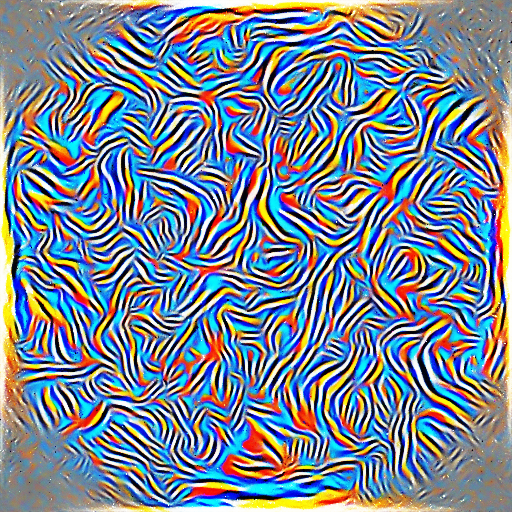

LAYER:  input
InceptionV1/InceptionV1/Conv2d_2c_3x3/Relu
LAYER:  input
LAYER:  InceptionV1/InceptionV1/Conv2d_2c_3x3/Relu
LAYER:  input
LAYER:  input



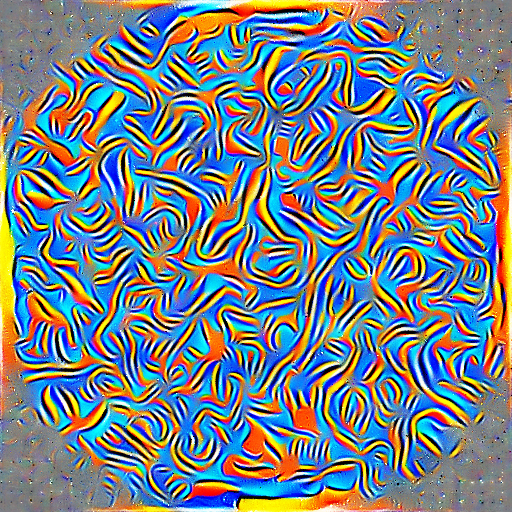

LAYER:  input
InceptionV1/InceptionV1/Mixed_3b/concat
LAYER:  input
LAYER:  InceptionV1/InceptionV1/Mixed_3b/concat
LAYER:  input
LAYER:  input



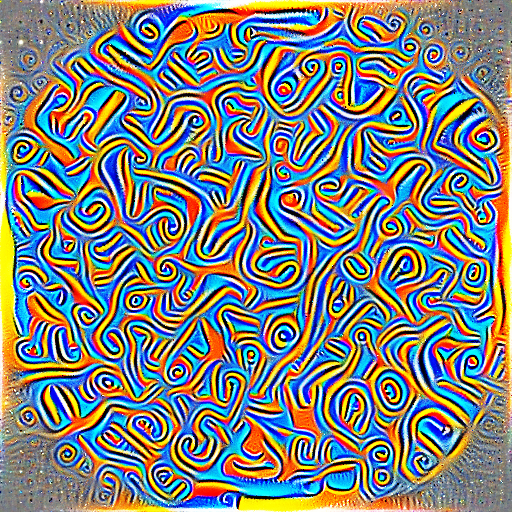

LAYER:  input
InceptionV1/InceptionV1/Mixed_3c/concat
LAYER:  input
LAYER:  InceptionV1/InceptionV1/Mixed_3c/concat
LAYER:  input
LAYER:  input



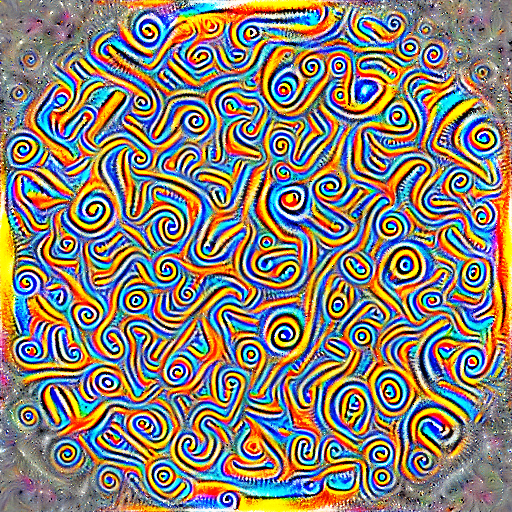

LAYER:  input
InceptionV1/InceptionV1/Mixed_4b/concat
LAYER:  input
LAYER:  InceptionV1/InceptionV1/Mixed_4b/concat
LAYER:  input
LAYER:  input



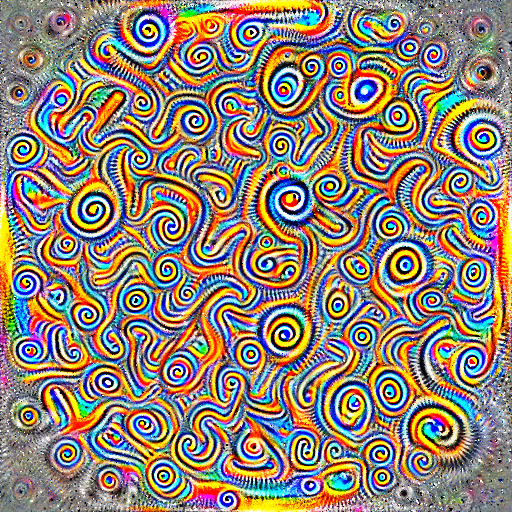

LAYER:  input
InceptionV1/InceptionV1/Mixed_4c/concat
LAYER:  input
LAYER:  InceptionV1/InceptionV1/Mixed_4c/concat
LAYER:  input
LAYER:  input



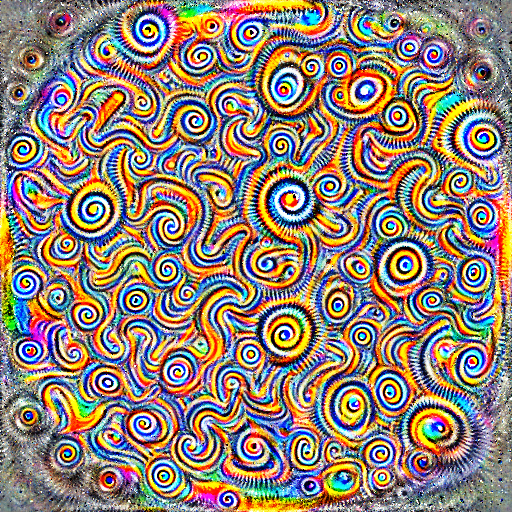

LAYER:  input
InceptionV1/InceptionV1/Mixed_4d/concat
LAYER:  input
LAYER:  InceptionV1/InceptionV1/Mixed_4d/concat
LAYER:  input
LAYER:  input



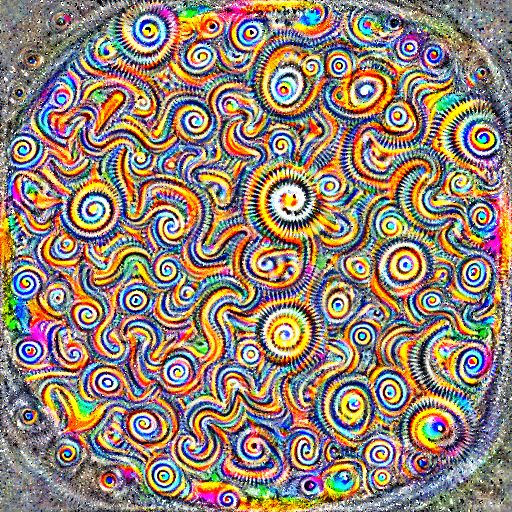

LAYER:  input
InceptionV1/InceptionV1/Mixed_4e/concat
LAYER:  input
LAYER:  InceptionV1/InceptionV1/Mixed_4e/concat
LAYER:  input
LAYER:  input



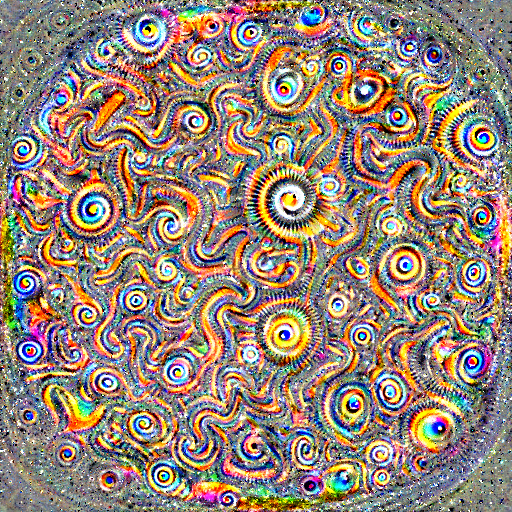

LAYER:  input
InceptionV1/InceptionV1/Mixed_4f/concat
LAYER:  input
LAYER:  InceptionV1/InceptionV1/Mixed_4f/concat
LAYER:  input
LAYER:  input



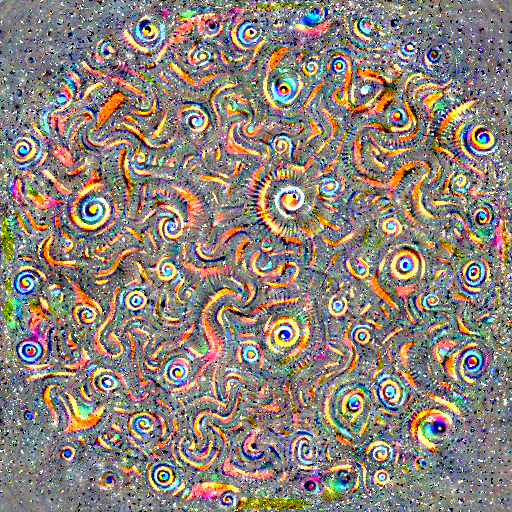

LAYER:  input
InceptionV1/InceptionV1/Mixed_5b/concat
LAYER:  input
LAYER:  InceptionV1/InceptionV1/Mixed_5b/concat
LAYER:  input
LAYER:  input



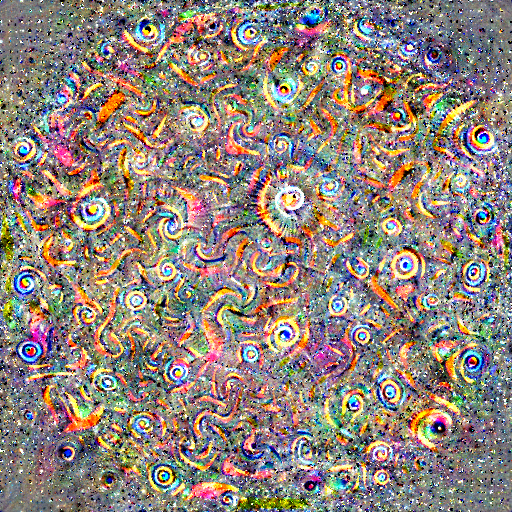

LAYER:  input
InceptionV1/InceptionV1/Mixed_5c/concat
LAYER:  input
LAYER:  InceptionV1/InceptionV1/Mixed_5c/concat
LAYER:  input
LAYER:  input



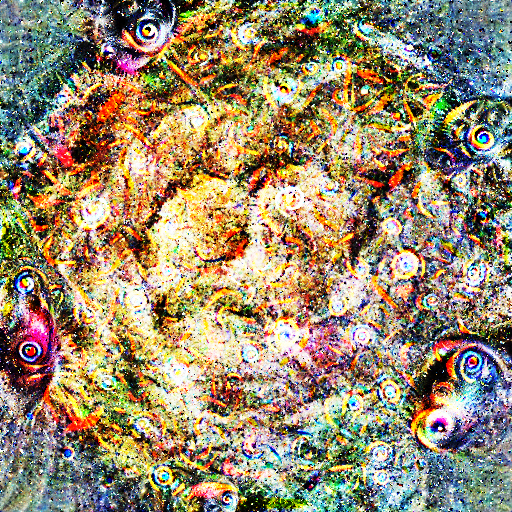

LAYER:  input


In [43]:
# I have a dream

from PIL import Image


def param_im(image=None):
  if image is None:
    image = param.image(512, decorrelate=True, fft=True, sd=0.42)
    # image = param.cppn(128, num_hidden_channels=3, num_layers=4)
  return image


vs = []

p = lambda: param_im()

thresholds = range(0, 512, 8)


with tf.Graph().as_default() as graph, tf.Session() as sess:

  T = None

  def dream(goal, T, param, thresholds, sess):
    if T is None:
      first = True
    else: 
      first = False
    T = make_flex_T(model, goal, param_f=param, T=T, 
                    transforms=[transform.random_rotate([137.5 * i % 180 for i in range(32)]),  
                                transform.jitter(1), 
                                transform.random_scale([1.61 * i % 1 for i in range(1, 17)])])
    # tf.initialize_all_variables().run()


    loss, vis_op, t_image = T("loss"), T("vis_op"), T("input")
    if first:
      tf.global_variables_initializer().run()
    else:
      tf.variables_initializer(tf.global_variables()[1:]).run()  # do not re-initialize image.


    images = []
    try:
      for i in range(max(thresholds)+1):
        loss_, _ = sess.run([loss, vis_op])
        if i in thresholds:
          vis = t_image.eval(session=sess)
          images.append(vis)
          
    except KeyboardInterrupt:
      log.warning("Interrupted optimization at step {:d}.".format(i+1))
      vis = t_image.eval()
      show(np.hstack(vis))

    return T, images


  LAYERS = model.layers[1:-1]
  count = 0

  for ln, l in enumerate(LAYERS):
    print(l.name)

    obj = objectives.deepdream(l.name)
    # obj -= 0.1 * objectives.blur_input_each_step()
    # obj *= 2
    # obj -= 0.01 * objectives.total_variation()
    obj -= 0.0042 * objectives.L2(constant=.5)  # for reducing acidity in rgb 
    # obj += objectives.diversity(l.name)
    # obj -= 0.005 * objectives.L1(constant=.5)

    T, images = dream(obj, T, p, thresholds, sess)
    # vs.append(images)

    for _, im in enumerate(images):
    
      Image.fromarray(np.array(im[0, :,:,:] * 255, dtype='uint8')).save('dreams/ihaveadream{:05d}.jpg'
      .format(count))
      count += 1

    show(images[-1])


    im = T("input")
    p = lambda: param_im(im)



In [17]:
# session probably crashed at this point
%cd /content/lucid

/content/lucid


In [44]:
!ffmpeg -i dreams/ihaveadream%05d.jpg -c:v libx264 -vf fps=8 -pix_fmt yuv420p _ihaveadream.mp4

ffmpeg version 3.4.6-0ubuntu0.18.04.1 Copyright (c) 2000-2019 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.3.0-16ubuntu3)
  configuration: --prefix=/usr --extra-version=0ubuntu0.18.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis --enable-libvpx --enable-libwavpack --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --ena

In [45]:
import moviepy.editor as mpy

display(mpy.ipython_display("_ihaveadream.mp4", height=512))
